In [33]:
"""
Notebook con analisis de presencia de caos y otros indicadores para datos SARS-CoV-II
de diferentes paises y ciudades
"""

'\nNotebook con analisis de presencia de caos y otros indicadores para datos SARS-CoV-II\nde diferentes paises y ciudades\n'

In [34]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scipy as sp
import statsmodels.api as sm
from matplotlib import animation

sns.set()


from nolitsa import data, dimension, delay, noise, lyapunov
from mpl_toolkits.mplot3d import Axes3D
from statsmodels.tsa.filters.hp_filter import hpfilter

from sklearn.metrics import mutual_info_score
from scipy.stats import chi2_contingency

# Se analizan los datos mediante $\texttt{R}$ con el paquete $\texttt{tseriesChaos}$

## Nueva York

In [90]:
data = pd.read_csv(r'C:/Users/ignac/OneDrive - Universidad de Chile/Escritorio/Practica-II-Covid-1/data/COVID-19_Daily_Counts_of_Cases__Hospitalizations__and_Deaths.csv', index_col='DATE_OF_INTEREST')

data_US_counties = pd.read_csv(r'C:\Users\ignac\OneDrive - Universidad de Chile\Escritorio\Practica-II-Covid-1\Presentacion\us-counties.csv', parse_dates=['date'], index_col='date')

data_LA = data_US_counties[data_US_counties['county'] == 'Los Angeles'].drop(columns=['county', 'fips', 'state'])
LA_cases = data_LA['cases'].diff().iloc[1:]
LA_deaths = data_LA['deaths'].diff().iloc[1:]

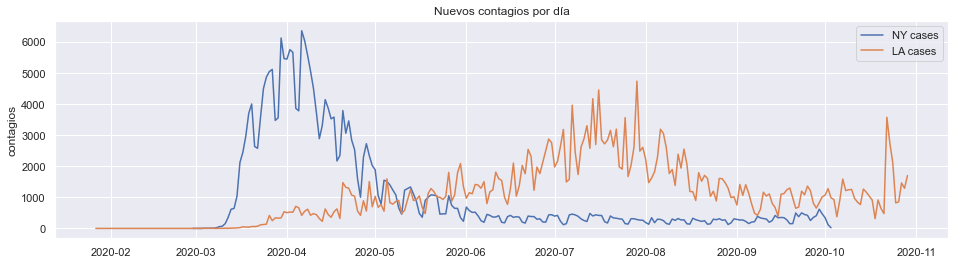

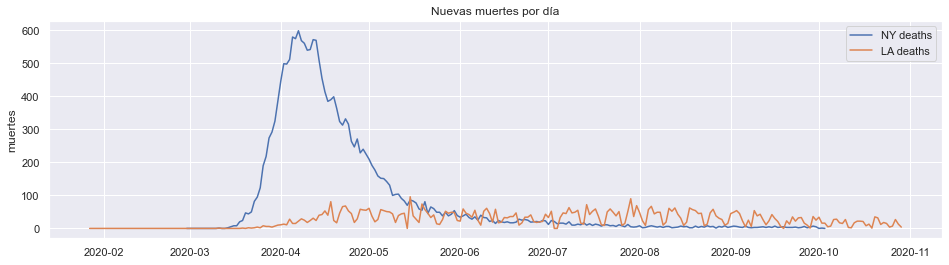

In [92]:
data.index = pd.to_datetime(data.index, format="%m/%d/%Y %I:%M:%S %p")#.strftime('%d/%m')
NY_deaths = data['DEATH_COUNT']
NY_cases  = data['CASE_COUNT'].str.replace(',', '').astype(float)

plt.figure(0, figsize=(16,4))
plt.clf()
plt.plot(NY_cases, label='NY cases')
plt.plot(LA_cases, label='LA cases')
plt.title('Nuevos contagios por día')
plt.ylabel('contagios')
plt.legend()
plt.show()

plt.figure(1, figsize=(16,4))
plt.clf()
plt.plot(NY_deaths, label='NY deaths')
plt.plot(LA_deaths, label='LA deaths')
plt.title('Nuevas muertes por día')
plt.ylabel('muertes')
plt.legend()
plt.show()

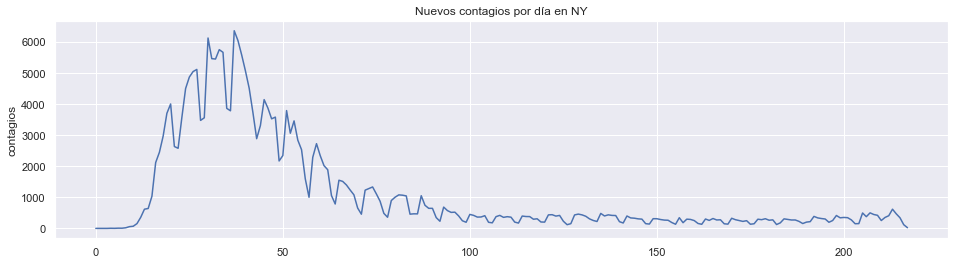

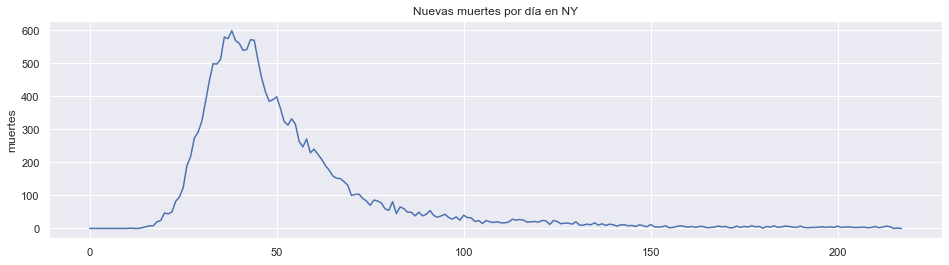

In [37]:
NY_deaths = np.array(data['DEATH_COUNT'])
NY_cases  = np.array(data['CASE_COUNT'].str.replace(',', '').astype(float))


plt.figure(0, figsize=(16,4))
plt.clf()
plt.plot(NY_cases)
plt.title('Nuevos contagios por día en NY')
plt.ylabel('contagios')
plt.show()

plt.figure(1, figsize=(16,4))
plt.clf()
plt.plot(NY_deaths)
plt.title('Nuevas muertes por día en NY')
plt.ylabel('muertes')
plt.show()

### Obtenemos el Promedio de Informacion Mutua (AMI) mediante R, para ello guardamos los datos en archivos csv

In [93]:
# Normalizamos las Series como en el paper de Canals

NY_cases = NY_cases / np.max(NY_cases)
NY_deaths = NY_deaths / np.max(NY_deaths)

In [94]:
# np.savetxt('NY_cases', NY_cases, delimiter=',')
# np.savetxt('NY_deaths', NY_deaths, delimiter=',')


In [95]:
AMI_NY = pd.read_csv(r'C:\Users\ignac\OneDrive - Universidad de Chile\Escritorio\Practica-II-Covid-1\Presentacion\AMI_NY.csv')
AMI_NY.head()

,mutual_NY_cases,mutual_NY_deaths
0,1.767584,1.489974
1,1.005691,1.124848
2,0.898677,1.065680
3,0.843918,1.069610
4,0.840583,1.043798


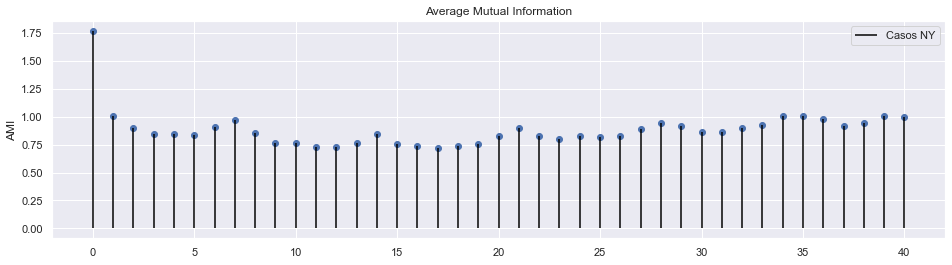

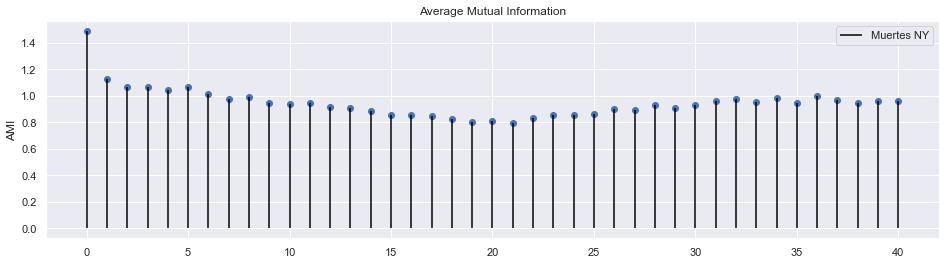

In [96]:
AMI_NY_cases = np.array(AMI_NY['mutual_NY_cases'])
AMI_NY_deaths = np.array(AMI_NY['mutual_NY_deaths'])

plt.figure(2, figsize=(16,4))
plt.clf()

plt.vlines(np.arange(len(AMI_NY_cases)), ymin=0, ymax=AMI_NY_cases, label='Casos NY', color='black')
plt.scatter(np.arange(len(AMI_NY_cases)), AMI_NY_cases, marker='o')

plt.legend()
plt.title('Average Mutual Information')
plt.ylabel('AMI')
plt.show()

plt.figure(3, figsize=(16,4))
plt.clf()

plt.vlines(np.arange(len(AMI_NY_deaths)), ymin=0, ymax=AMI_NY_deaths, label='Muertes NY', color='black')
plt.scatter(np.arange(len(AMI_NY_deaths)), AMI_NY_deaths, marker='o')

plt.legend()
plt.title('Average Mutual Information')
plt.ylabel('AMI')
plt.show()


### Con esto, sacampos candidatos a Delay

In [97]:
delay_NY_cases = []
delay_NY_deaths = []

for i in range(len(AMI_NY_cases)-2):
    if AMI_NY_cases[i] > AMI_NY_cases[i+1] and AMI_NY_cases[i+2] > AMI_NY_cases[i+1]:
        delay_NY_cases.append(i+1)

for i in range(len(AMI_NY_deaths)-2):
    if AMI_NY_deaths[i] > AMI_NY_deaths[i+1] and AMI_NY_deaths[i+2] > AMI_NY_deaths[i+1]:
        delay_NY_deaths.append(i+1)

print('Tiempos de Retardo para NY casos:', delay_NY_cases)
print('Tiempos de Retardo para NY muertes:', delay_NY_deaths)

Tiempos de Retardo para NY casos: [5, 11, 17, 23, 25, 31, 37]
Tiempos de Retardo para NY muertes: [2, 4, 7, 10, 15, 19, 21, 24, 27, 29, 33, 35, 38]


### Calculamos la dimension de inmersion con FNN mediante el paquete $\texttt{nolitsa}$ en Python, el cual ocupa el método descrito en Kennel et al. (1992)

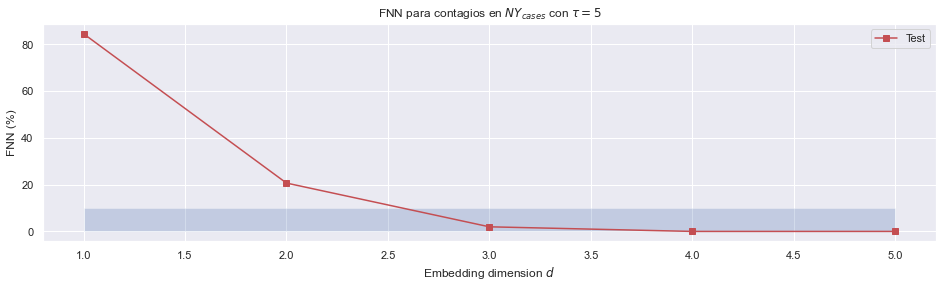

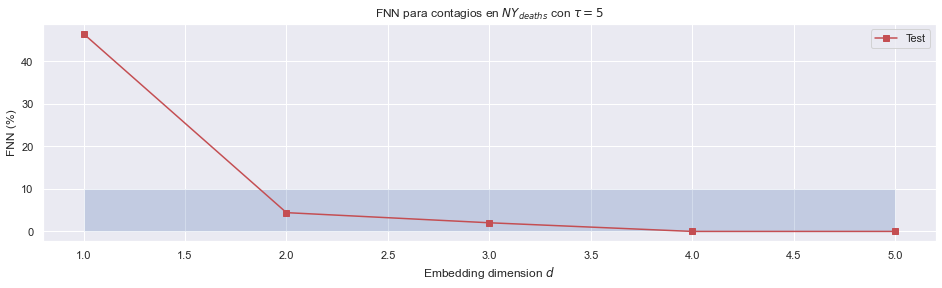

In [98]:
# m.max<- 6 # embedding dimensions: from 1 to m_max
# d<- 5 # tentative time delay (see below)
# tw<- 5 # Theiler window
# rt<- 10 # escape factor
# eps<- sd(ny_cases)/10

dim = np.arange(1, 6)
f1, f2, f3 = dimension.fnn(NY_cases, tau=5, dim=dim, window=5) #, metric='chebyshev')

plt.figure(4, figsize=(16,4))
plt.clf()
plt.title('FNN para contagios en $NY_{cases}$ con $\\tau=5$')
plt.xlabel('Embedding dimension $d$')
plt.ylabel('FNN (%)')
plt.plot(dim, 100 * f1, 'rs-', label=r'Test')
#plt.plot(dim, 100 * f2, 'g^--', label=r'Test II')
#plt.plot(dim, 100 * f3, 'rs-', label=r'Test I + II')
plt.fill_between(dim, 10, alpha=0.25)
plt.legend()
plt.show()

f1, f2, f3 = dimension.fnn(NY_deaths, tau=7, dim=dim, window=10) #, metric='chebyshev')

plt.figure(5, figsize=(16,4))
plt.clf()
plt.title('FNN para contagios en $NY_{deaths}$ con $\\tau=5$')
plt.xlabel('Embedding dimension $d$')
plt.ylabel('FNN (%)')
plt.plot(dim, 100 * f1, 'rs-', label=r'Test')
#plt.plot(dim, 100 * f2, 'g^--', label=r'Test II')
#plt.plot(dim, 100 * f3, 'rs-', label=r'Test I + II')
plt.fill_between(dim, 10, alpha=0.25)
plt.legend()
plt.show()

### Ploteamos el atractor

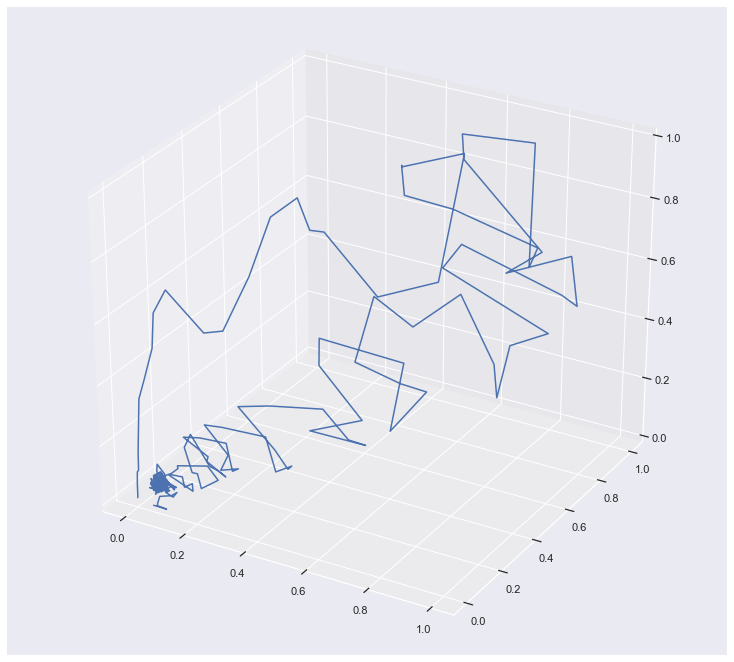

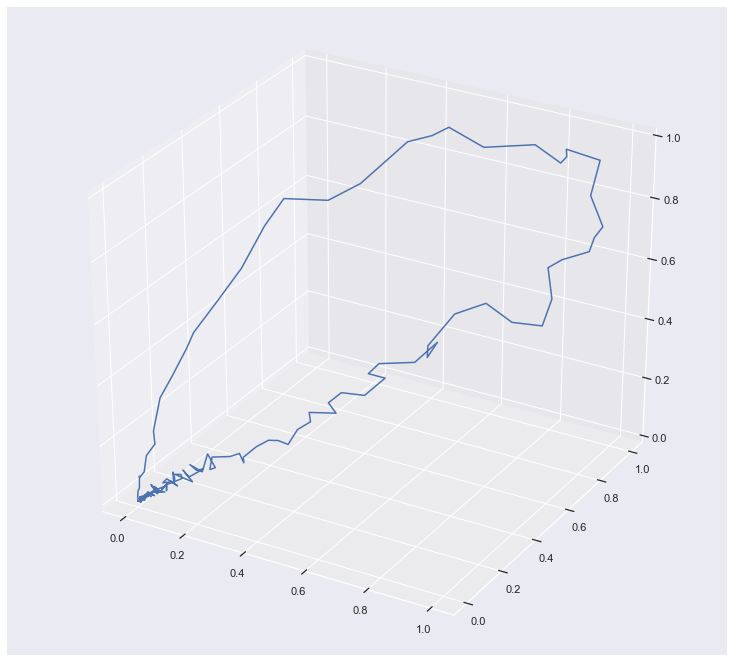

In [54]:
tau_NY_cases = 5

figg = plt.figure(6, figsize=(10, 9))
plt.clf()
axes = Axes3D(figg)
data_lag0 = np.array(NY_cases)[:-2].flatten()
data_lag1 = np.roll(np.array(NY_cases), -tau_NY_cases)[:-2].flatten()
data_lag2 = np.roll(np.array(NY_cases), -2 * tau_NY_cases)[:-2].flatten()
axes.plot3D(data_lag0, data_lag1, data_lag2)
figg.add_axes(axes)
plt.show()

tau_NY_deaths = 4

figg = plt.figure(7, figsize=(10, 9))
plt.clf()
axes = Axes3D(figg)
data_lag0 = np.array(NY_deaths)[:-2].flatten()
data_lag1 = np.roll(np.array(NY_deaths), -tau_NY_deaths)[:-2].flatten()
data_lag2 = np.roll(np.array(NY_deaths), -2 * tau_NY_deaths)[:-2].flatten()
axes.plot3D(data_lag0, data_lag1, data_lag2)
figg.add_axes(axes)
plt.show()

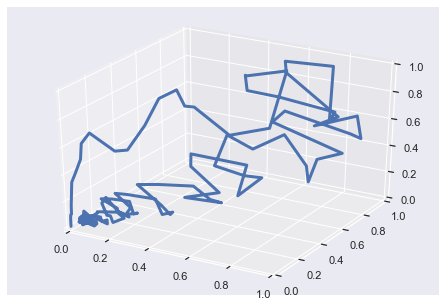

In [104]:
fig = plt.figure(16)
plt.clf()
axes = Axes3D(fig, xlim=(0, 1), ylim=(0, 1), zlim=(0, 1))

line, = axes.plot([], [], [], lw=3)

def init():
    line.set_data([], [], [])
    return line, 

def animate(i):
    X = np.array(NY_cases)[:-2].flatten()[:i]
    Y = np.roll(np.array(NY_cases), -tau_NY_cases)[:-2].flatten()[:i]
    Z = np.roll(np.array(NY_cases), -2 * tau_NY_cases)[:-2].flatten()[:i]
    line.set_data(X, Y)
    line.set_3d_properties(Z)
    return line,

anim = animation.FuncAnimation(fig, animate, # init_func=init,
                               frames=210, interval=40, blit=True)

from IPython.display import HTML
HTML(anim.to_jshtml())

### Hacemos un analisis para la Theiler Window, viendo que en el caso de muertes existe mucha separacion entre trayectorias distintas (ver figura arriba e imagen), mientras que en el numero de casos es más posible tomar trayectorias distintas

### Calculemos el Maximo Coeficiente del Exponente de Lyapunov (MCLE) mediante $\texttt{tseriesChaos}$

- series: time series.
- m: embedding dimension.
- d: time delay.
- t: Theiler window. Points separated by less than t in the series series are excluded from the search for neighbouring points.
- k: number of neighbours considered.
- ref: number of points in series taken into account.
- s: iterations along which the neighbours of each point are followed.
- eps: radius of the ball inside which nearest neighbours are searched for.

In [56]:
S_nu_NY = pd.read_csv(r'C:\Users\ignac\OneDrive - Universidad de Chile\Escritorio\Practica-II-Covid-1\Presentacion\S_nu_NY.csv')
S_nu_NY.head()

,S_nu_NY_cases,S_nu_NY_deaths
0,-3.977778,-4.062185
1,-3.252414,-3.750316
2,-3.466398,-3.717792
3,-3.369834,-3.695005
4,-3.349550,-3.810812


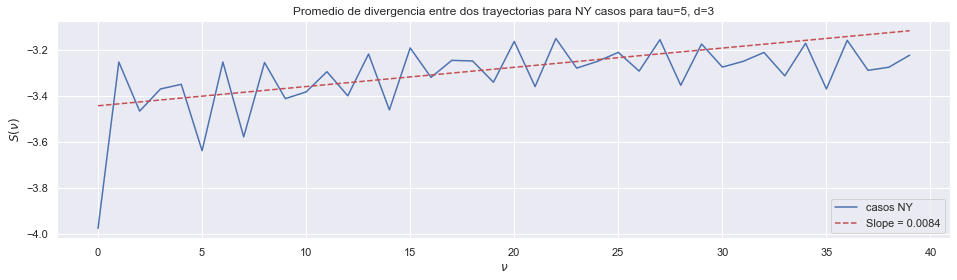

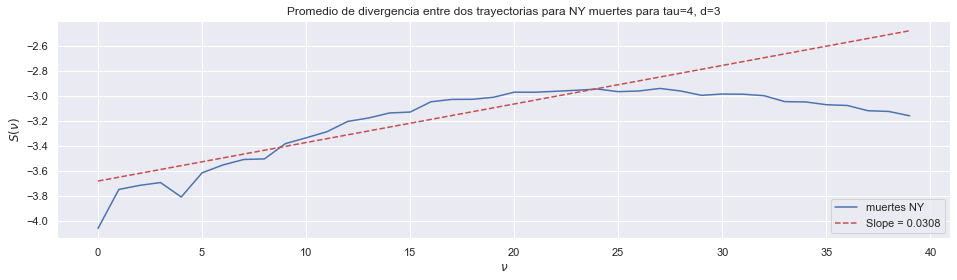

In [99]:
S_nu_NY_cases = S_nu_NY['S_nu_NY_cases']
S_nu_NY_deaths = S_nu_NY['S_nu_NY_deaths']

nu = np.arange(len(S_nu_NY_cases))

MCLE_NY_cases, intercept, r_value, p_value, std_err = sp.stats.linregress(nu[3:30], S_nu_NY_cases[3:30])

plt.figure(8, figsize=(16,4))
plt.clf()
plt.plot(nu, S_nu_NY_cases, label='casos NY')
plt.plot(nu, MCLE_NY_cases*nu + intercept, linestyle='--', label='Slope = {:.4f}'.format(MCLE_NY_cases), color='r')
plt.title('Promedio de divergencia entre dos trayectorias para NY casos para tau={}, d=3'.format(tau_NY_cases))
plt.ylabel('$S(\\nu)$')
plt.xlabel('$\\nu$')
plt.legend(loc=4)
plt.show()

nu = np.arange(len(S_nu_NY_deaths))

MCLE_NY_deaths, intercept, r_value, p_value, std_err = sp.stats.linregress(nu[3:30], S_nu_NY_deaths[3:30])

plt.figure(8, figsize=(16,4))
plt.clf()
plt.plot(nu, S_nu_NY_deaths, label='muertes NY')
plt.plot(nu, MCLE_NY_deaths*nu + intercept, linestyle='--', label='Slope = {:.4f}'.format(MCLE_NY_deaths), color='r')
plt.title('Promedio de divergencia entre dos trayectorias para NY muertes para tau={}, d=3'.format(tau_NY_deaths))
plt.ylabel('$S(\\nu)$')
plt.xlabel('$\\nu$')
plt.legend(loc=4)
plt.show()


In [59]:
data = {'': ['NY casos', 'NY muertes'], 'MCLE': 365*np.round([MCLE_NY_cases, MCLE_NY_deaths], 4),'delay': [5, 4]}
NN = pd.DataFrame(data)
NN

,,MCLE,delay
0,NY casos,3.066,5
1,NY muertes,11.242,4


# Santiago de Chile

In [60]:
data_casos_regiones = pd.read_csv(r'C:\Users\ignac\OneDrive - Universidad de Chile\Escritorio\Datos-COVID19\output\producto13\CasosNuevosCumulativo_T.csv', parse_dates=['Region'], index_col='Region')

# data_casos_regiones

In [61]:
data_icovid = pd.read_csv(r'C:\Users\ignac\OneDrive - Universidad de Chile\Escritorio\Datos-COVID19\output\producto53\confirmados_regionales.csv', parse_dates=['fecha'], index_col='fecha')

data_icovid_SCL = data_icovid[data_icovid['Codigo region'] == 13]
data_icovid_SCL = data_icovid_SCL['confirmados.90']

In [62]:
data_muertes_SCL = pd.read_csv(r'C:\Users\ignac\OneDrive - Universidad de Chile\Escritorio\Datos-COVID19\output\producto14\FallecidosCumulativo_T.csv', parse_dates=['Region'], index_col='Region')

data_muertes_SCL = data_muertes_SCL['Metropolitana'].diff().dropna()

In [63]:
data_muertes_chile_deis = pd.read_csv(r'C:\Users\ignac\OneDrive - Universidad de Chile\Escritorio\Datos-COVID19\output\producto37\Defunciones_deis_T.csv', skiprows=[1,2], parse_dates=['Serie'], index_col='Serie')

data_muertes_chile = data_muertes_chile_deis['confirmados.105']

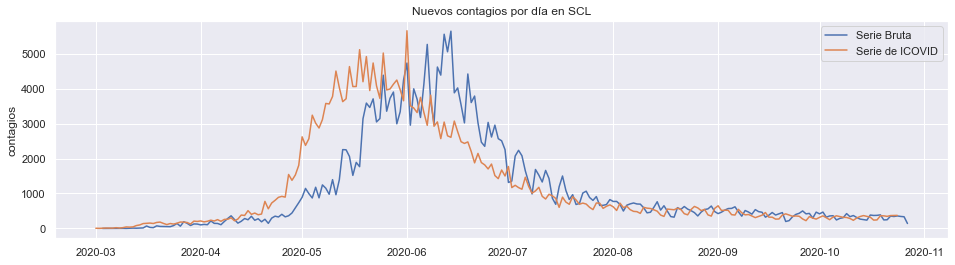

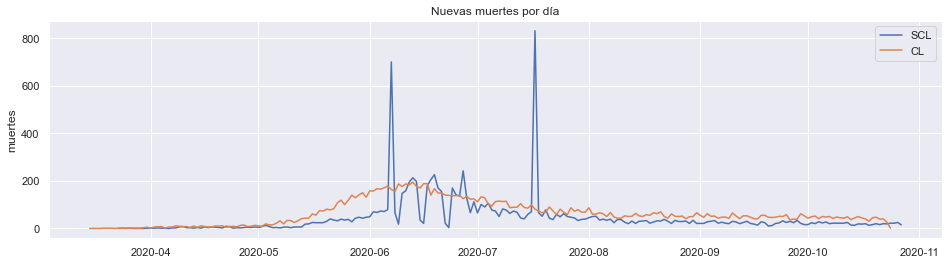

In [64]:
SCL_cases = data_casos_regiones['Metropolitana']
SCL_cases_icovid = data_icovid_SCL

SCL_deaths  = data_muertes_SCL
CL_deaths = data_muertes_chile


plt.figure(0, figsize=(16,4))
plt.clf()
plt.plot(SCL_cases, label='Serie Bruta')
plt.plot(SCL_cases_icovid, label='Serie de ICOVID')
plt.title('Nuevos contagios por día en SCL')
plt.ylabel('contagios')
plt.legend()
plt.show()

plt.figure(1, figsize=(16,4))
plt.clf()
plt.plot(SCL_deaths, label='SCL')
plt.plot(CL_deaths, label='CL')
plt.title('Nuevas muertes por día')
plt.ylabel('muertes')
plt.legend()
plt.show()

In [65]:
SCL_cases = np.array(data_casos_regiones['Metropolitana'])
SCL_cases_icovid = np.array(data_icovid_SCL)

SCL_deaths  = np.array(data_muertes_SCL)
CL_deaths = np.array(data_muertes_chile)

### Obtenemos el Promedio de Informacion Mutua (AMI) mediante R


#### Primero pasamos los datos a csv para leerlos en R

In [66]:
SCL_cases = SCL_cases / np.max(SCL_cases)
SCL_cases_icovid = SCL_cases_icovid / np.max(SCL_cases_icovid)

SCL_deaths  = SCL_deaths / np.max(SCL_deaths)
CL_deaths = CL_deaths / np.max(CL_deaths)

# np.savetxt('SCL_cases', SCL_cases, delimiter=',')
# np.savetxt('SCL_cases_icovid', SCL_cases_icovid, delimiter=',')

# np.savetxt('SCL_deaths', SCL_deaths, delimiter=',')
# np.savetxt('CL_deaths', CL_deaths, delimiter=',')


In [67]:
AMI_SCL_CL = pd.read_csv(r'C:\Users\ignac\OneDrive - Universidad de Chile\Escritorio\Practica-II-Covid-1\Presentacion\AMI_SCL_CL.csv')
AMI_SCL_CL.head()

,mutual_SCL_cases,mutual_SCL_cases_icovid,mutual_SCL_deaths,mutual_CL_deaths
0,2.009155,2.049211,0.739265,2.419986
1,1.135077,1.264397,0.317268,1.355338
2,1.048432,1.203908,0.279110,1.346239
3,1.010952,1.216239,0.252547,1.347500
4,0.975230,1.210283,0.237870,1.308811


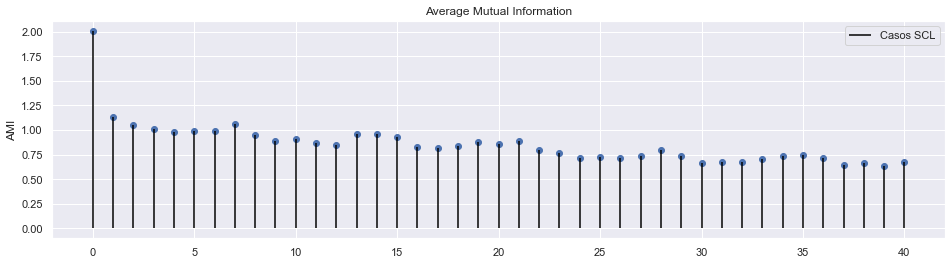

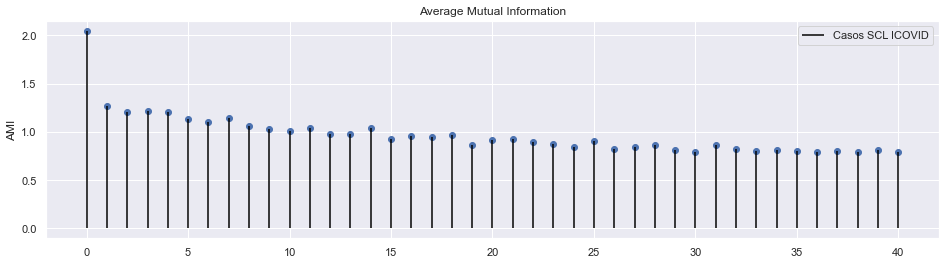

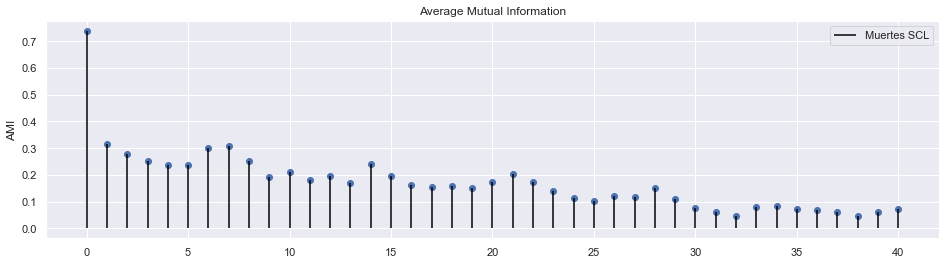

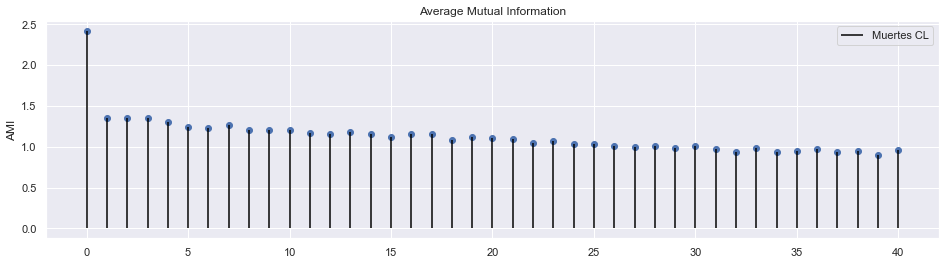

In [69]:
AMI_SCL_cases = np.array(AMI_SCL_CL['mutual_SCL_cases'])
AMI_SCL_cases_icovid = np.array(AMI_SCL_CL['mutual_SCL_cases_icovid'])

AMI_SCL_deaths = np.array(AMI_SCL_CL['mutual_SCL_deaths'])
AMI_CL_deaths = np.array(AMI_SCL_CL['mutual_CL_deaths'])

plt.figure(2, figsize=(16,4))
plt.clf()

plt.vlines(np.arange(41), ymin=0, ymax=AMI_SCL_cases, label='Casos SCL', color='black')
plt.scatter(np.arange(41), AMI_SCL_cases, marker='o')

plt.legend()
plt.title('Average Mutual Information')
plt.ylabel('AMI')
plt.show()

plt.figure(3, figsize=(16,4))
plt.clf()

plt.vlines(np.arange(41), ymin=0, ymax=AMI_SCL_cases_icovid, label='Casos SCL ICOVID', color='black')
plt.scatter(np.arange(41), AMI_SCL_cases_icovid, marker='o')

plt.legend()
plt.title('Average Mutual Information')
plt.ylabel('AMI')
plt.show()

plt.figure(3, figsize=(16,4))
plt.clf()

plt.vlines(np.arange(41), ymin=0, ymax=AMI_SCL_deaths, label='Muertes SCL', color='black')
plt.scatter(np.arange(41), AMI_SCL_deaths, marker='o')

plt.legend()
plt.title('Average Mutual Information')
plt.ylabel('AMI')
plt.show()

plt.figure(3, figsize=(16,4))
plt.clf()

plt.vlines(np.arange(41), ymin=0, ymax=AMI_CL_deaths, label='Muertes CL', color='black')
plt.scatter(np.arange(41), AMI_CL_deaths, marker='o')

plt.legend()
plt.title('Average Mutual Information')
plt.ylabel('AMI')
plt.show()

In [70]:
delay_SCL_cases = []
delay_SCL_cases_icovid = []

delay_SCL_deaths = []
delay_CL_deaths = []

for i in range(len(AMI_SCL_cases)-2):
    if AMI_SCL_cases[i] > AMI_SCL_cases[i+1] and AMI_SCL_cases[i+2] > AMI_SCL_cases[i+1]:
        delay_SCL_cases.append(i+1)

for i in range(len(AMI_SCL_cases_icovid)-2):
    if AMI_SCL_cases_icovid[i] > AMI_SCL_cases_icovid[i+1] and AMI_SCL_cases_icovid[i+2] > AMI_SCL_cases_icovid[i+1]:
        delay_SCL_cases_icovid.append(i+1)

for i in range(len(AMI_SCL_deaths)-2):
    if AMI_SCL_deaths[i] > AMI_SCL_deaths[i+1] and AMI_SCL_deaths[i+2] > AMI_SCL_deaths[i+1]:
        delay_SCL_deaths.append(i+1)

for i in range(len(AMI_CL_deaths)-2):
    if AMI_CL_deaths[i] > AMI_CL_deaths[i+1] and AMI_CL_deaths[i+2] > AMI_CL_deaths[i+1]:
        delay_CL_deaths.append(i+1)

print('Tiempos de Retardo para SCL casos:', delay_SCL_cases)
print('Tiempos de Retardo para SCL casos ICOVID:', delay_SCL_cases_icovid)
print('Tiempos de Retardo para SCL muertes:', delay_SCL_deaths)
print('Tiempos de Retardo para CL muertes:', delay_CL_deaths)

Tiempos de Retardo para SCL casos: [4, 9, 12, 17, 20, 24, 26, 30, 32, 37, 39]
Tiempos de Retardo para SCL casos ICOVID: [2, 6, 10, 12, 15, 17, 19, 24, 26, 30, 33, 36, 38]
Tiempos de Retardo para SCL muertes: [5, 9, 11, 13, 17, 19, 25, 27, 32, 38]
Tiempos de Retardo para CL muertes: [2, 6, 8, 12, 15, 18, 22, 24, 27, 29, 32, 34, 37, 39]


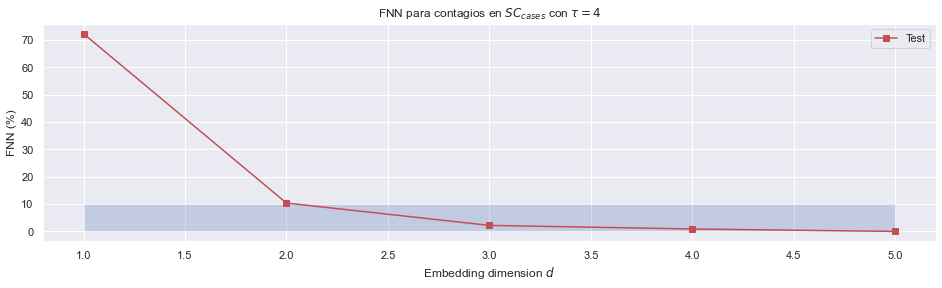

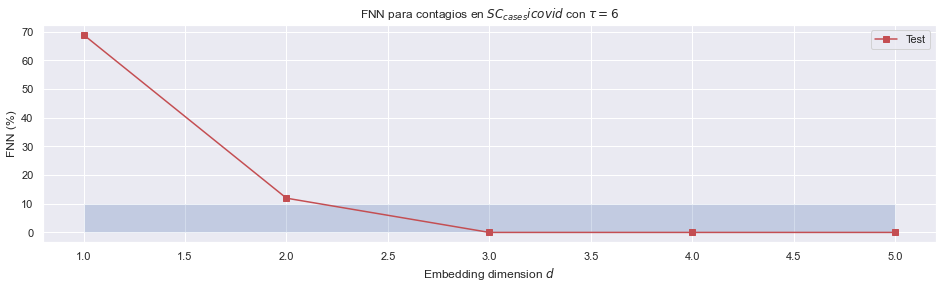

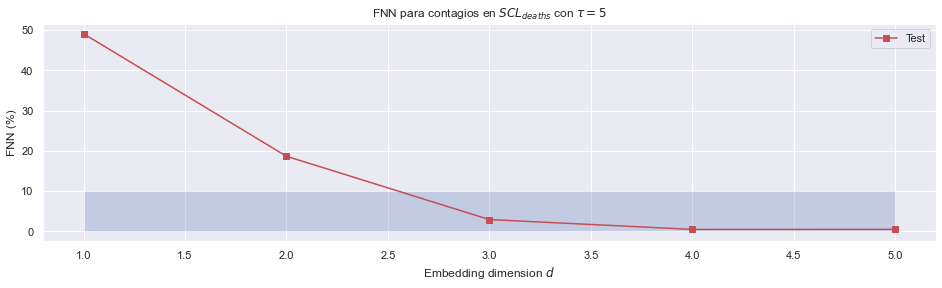

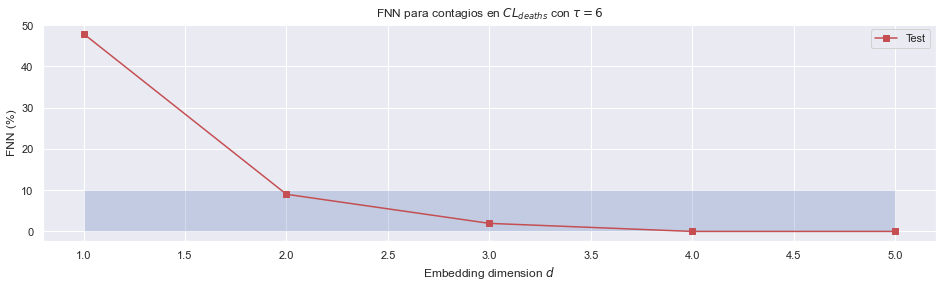

In [71]:
dim = np.arange(1, 6)
f1, f2, f3 = dimension.fnn(SCL_cases, tau=4, dim=dim, window=6) #, metric='chebyshev')

plt.figure(4, figsize=(16,4))
plt.clf()
plt.title('FNN para contagios en $SC_{cases}$ con $\\tau=4$')
plt.xlabel('Embedding dimension $d$')
plt.ylabel('FNN (%)')
plt.plot(dim, 100 * f1, 'rs-', label=r'Test')
#plt.plot(dim, 100 * f2, 'g^--', label=r'Test II')
#plt.plot(dim, 100 * f3, 'rs-', label=r'Test I + II')
plt.fill_between(dim, 10, alpha=0.25)
plt.legend()
plt.show()

f1, f2, f3 = dimension.fnn(SCL_cases_icovid, tau=6, dim=dim, window=7) #, metric='chebyshev')

plt.figure(4, figsize=(16,4))
plt.clf()
plt.title('FNN para contagios en $SC_{cases} icovid$ con $\\tau=6$')
plt.xlabel('Embedding dimension $d$')
plt.ylabel('FNN (%)')
plt.plot(dim, 100 * f1, 'rs-', label=r'Test')
#plt.plot(dim, 100 * f2, 'g^--', label=r'Test II')
#plt.plot(dim, 100 * f3, 'rs-', label=r'Test I + II')
plt.fill_between(dim, 10, alpha=0.25)
plt.legend()
plt.show()

f1, f2, f3 = dimension.fnn(SCL_deaths, tau=5, dim=dim, window=11) #, metric='chebyshev')

plt.figure(5, figsize=(16,4))
plt.clf()
plt.title('FNN para contagios en $SCL_{deaths}$ con $\\tau=5$')
plt.xlabel('Embedding dimension $d$')
plt.ylabel('FNN (%)')
plt.plot(dim, 100 * f1, 'rs-', label=r'Test')
#plt.plot(dim, 100 * f2, 'g^--', label=r'Test II')
#plt.plot(dim, 100 * f3, 'rs-', label=r'Test I + II')
plt.fill_between(dim, 10, alpha=0.25)
plt.legend()
plt.show()

f1, f2, f3 = dimension.fnn(CL_deaths, tau=6, dim=dim, window=13) #, metric='chebyshev')

plt.figure(5, figsize=(16,4))
plt.clf()
plt.title('FNN para contagios en $CL_{deaths}$ con $\\tau=6$')
plt.xlabel('Embedding dimension $d$')
plt.ylabel('FNN (%)')
plt.plot(dim, 100 * f1, 'rs-', label=r'Test')
#plt.plot(dim, 100 * f2, 'g^--', label=r'Test II')
#plt.plot(dim, 100 * f3, 'rs-', label=r'Test I + II')
plt.fill_between(dim, 10, alpha=0.25)
plt.legend()
plt.show()

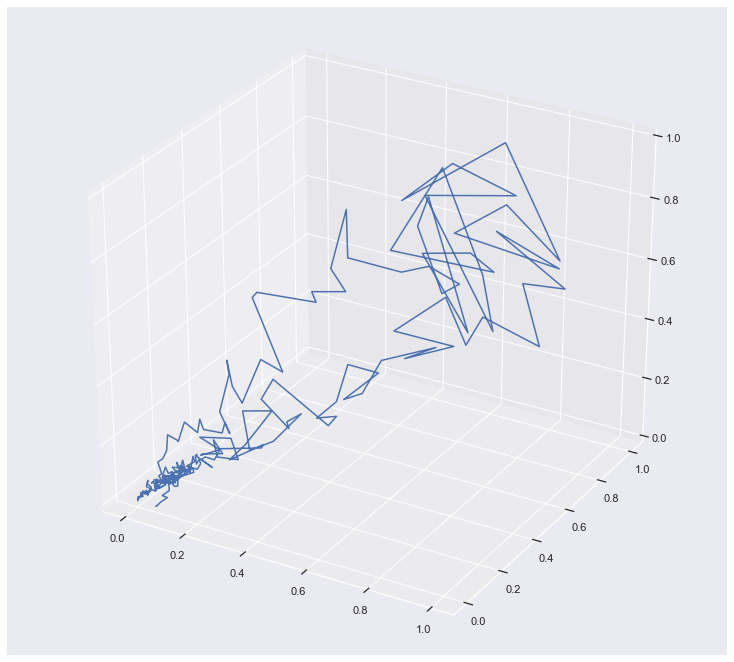

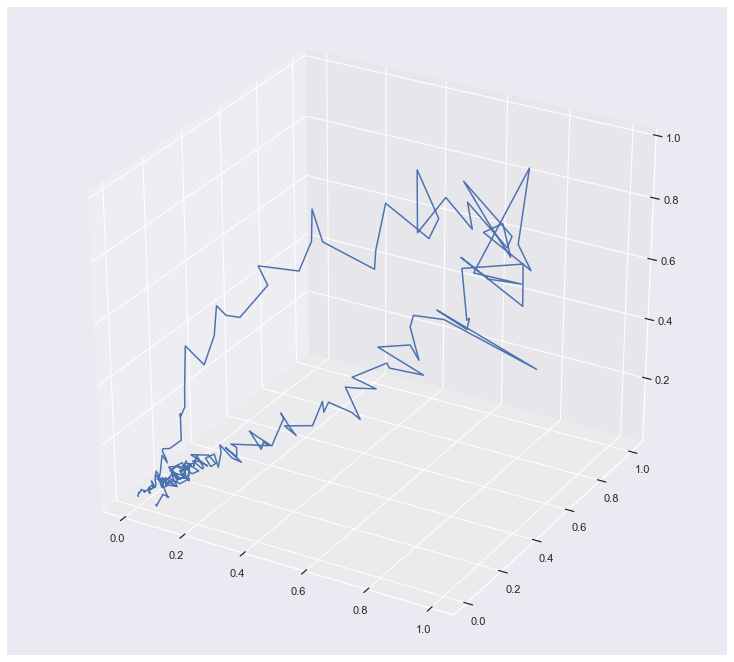

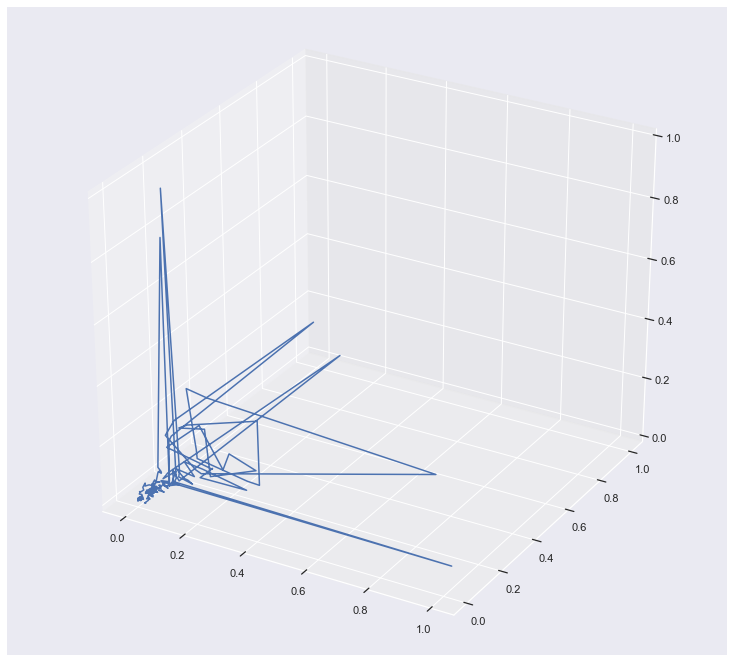

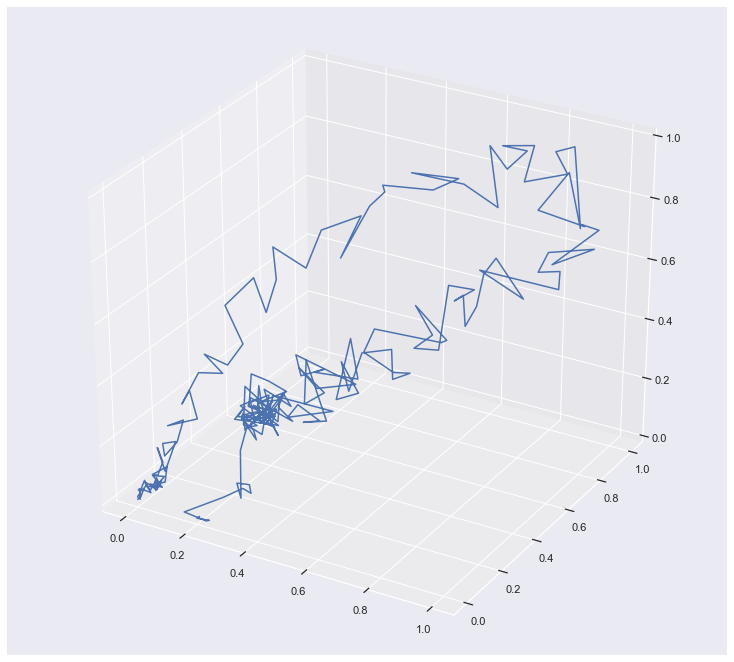

In [72]:
tau_SCL_cases = 4

figg = plt.figure(6, figsize=(10, 9))
plt.clf()
axes = Axes3D(figg)
data_lag0 = np.array(SCL_cases)[:-2].flatten()
data_lag1 = np.roll(np.array(SCL_cases), -tau_SCL_cases)[:-2].flatten()
data_lag2 = np.roll(np.array(SCL_cases), -2 * tau_SCL_cases)[:-2].flatten()
axes.plot3D(data_lag0, data_lag1, data_lag2)
figg.add_axes(axes)
plt.show()

tau_SCL_cases_icovid = 6

figg = plt.figure(6, figsize=(10, 9))
plt.clf()
axes = Axes3D(figg)
data_lag0 = np.array(SCL_cases_icovid)[:-2].flatten()
data_lag1 = np.roll(np.array(SCL_cases_icovid), -tau_SCL_cases_icovid)[:-2].flatten()
data_lag2 = np.roll(np.array(SCL_cases_icovid), -2 * tau_SCL_cases_icovid)[:-2].flatten()
axes.plot3D(data_lag0, data_lag1, data_lag2)
figg.add_axes(axes)
plt.show()

tau_SCL_deaths = 5

figg = plt.figure(7, figsize=(10, 9))
plt.clf()
axes = Axes3D(figg)
data_lag0 = np.array(SCL_deaths)[:-2].flatten()
data_lag1 = np.roll(np.array(SCL_deaths), -tau_SCL_deaths)[:-2].flatten()
data_lag2 = np.roll(np.array(SCL_deaths), -2 * tau_SCL_deaths)[:-2].flatten()
axes.plot3D(data_lag0, data_lag1, data_lag2)
figg.add_axes(axes)
plt.show()

tau_CL_deaths = 6

figg = plt.figure(7, figsize=(10, 9))
plt.clf()
axes = Axes3D(figg)
data_lag0 = np.array(CL_deaths)[:-2].flatten()
data_lag1 = np.roll(np.array(CL_deaths), -tau_CL_deaths)[:-2].flatten()
data_lag2 = np.roll(np.array(CL_deaths), -2 * tau_CL_deaths)[:-2].flatten()
axes.plot3D(data_lag0, data_lag1, data_lag2)
figg.add_axes(axes)
plt.show()

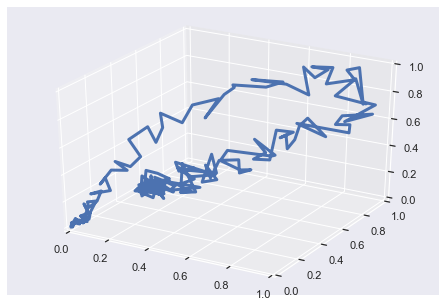

In [74]:
fig = plt.figure(16)
plt.clf()
axes = Axes3D(fig, xlim=(0, 1), ylim=(0, 1), zlim=(0, 1))

line, = axes.plot([], [], [], lw=3)

def init():
    line.set_data([], [], [])
    return line, 

def animate(i):
    X = np.array(CL_deaths)[:-2].flatten()[:i]
    Y = np.roll(np.array(CL_deaths), -tau_CL_deaths)[:-2].flatten()[:i]
    Z = np.roll(np.array(CL_deaths), -2 * tau_CL_deaths)[:-2].flatten()[:i]
    line.set_data(X, Y)
    line.set_3d_properties(Z)
    return line,

anim = animation.FuncAnimation(fig, animate, # init_func=init,
                               frames=200, interval=40, blit=True)

from IPython.display import HTML
HTML(anim.to_jshtml())

### Calculemos el Maximo Coeficiente del Exponente de Lyapunov (MCLE) mediante $\texttt{tseriesChaos}$

- series: time series.
- m: embedding dimension.
- d: time delay.
- t: Theiler window. Points separated by less than t in the series series are excluded from the search for neighbouring points.
- k: number of neighbours considered.
- ref: number of points in series taken into account.
- s: iterations along which the neighbours of each point are followed.
- eps: radius of the ball inside which nearest neighbours are searched for.

In [77]:
S_nu_SCL_CL = pd.read_csv(r'C:\Users\ignac\OneDrive - Universidad de Chile\Escritorio\Practica-II-Covid-1\Presentacion\S_nu_SCL_CL.csv')
S_nu_SCL_CL.head()

,S_nu_SCL_cases,S_nu_SCL_cases_icovid,S_nu_SCL_deaths,S_nu_CL_deaths
0,-2.938271,-3.409359,-4.108487,-2.882942
1,-2.556962,-3.059431,-3.488818,-2.359626
2,-2.512811,-2.898117,-3.402023,-2.303173
3,-2.452678,-2.902854,-3.370028,-2.334488
4,-2.552834,-2.852681,-3.309659,-2.282400


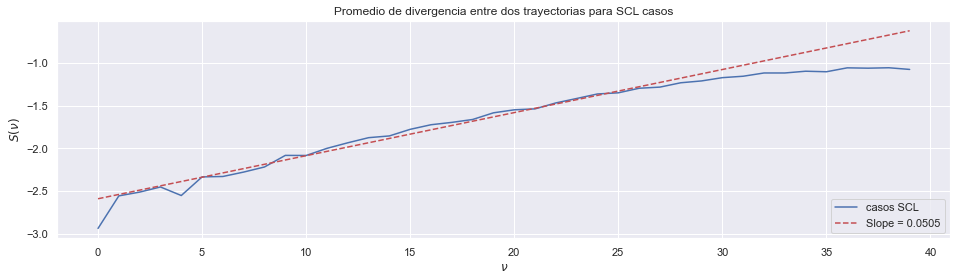

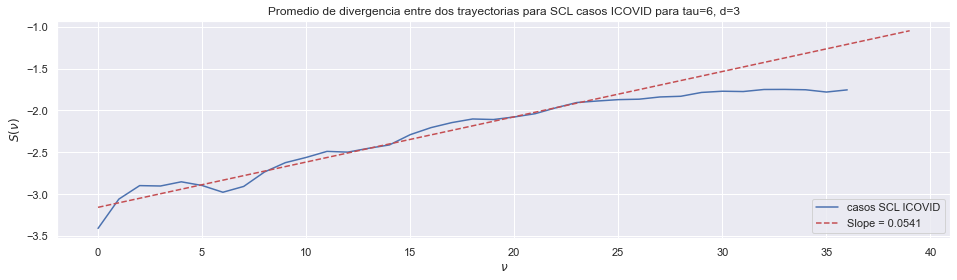

In [100]:
S_nu_SCL_cases = S_nu_SCL_CL['S_nu_SCL_cases']
S_nu_SCL_cases_icovid = S_nu_SCL_CL['S_nu_SCL_cases_icovid']
S_nu_SCL_deaths = S_nu_SCL_CL['S_nu_SCL_deaths']
S_nu_CL_deaths = S_nu_SCL_CL['S_nu_CL_deaths']

nu = np.arange(len(S_nu_SCL_cases))

MCLE_SCL_cases, intercept, r_value, p_value, std_err = sp.stats.linregress(nu[3:30], S_nu_SCL_cases[3:30])

plt.figure(8, figsize=(16,4))
plt.clf()
plt.plot(nu, S_nu_SCL_cases, label='casos SCL')
plt.plot(nu, MCLE_SCL_cases*nu + intercept, linestyle='--', label='Slope = {:.4f}'.format(MCLE_SCL_cases), color='r')
plt.title('Promedio de divergencia entre dos trayectorias para SCL casos')
plt.ylabel('$S(\\nu)$')
plt.xlabel('$\\nu$')
plt.legend(loc=4)
plt.show()

nu = np.arange(len(S_nu_SCL_cases_icovid))

MCLE_SCL_cases_icovid, intercept, r_value, p_value, std_err = sp.stats.linregress(nu[5:27], S_nu_SCL_cases_icovid[5:27])

plt.figure(8, figsize=(16,4))
plt.clf()
plt.plot(nu, S_nu_SCL_cases_icovid, label='casos SCL ICOVID')
plt.plot(nu, MCLE_SCL_cases_icovid*nu + intercept, linestyle='--', label='Slope = {:.4f}'.format(MCLE_SCL_cases_icovid), color='r')
plt.title('Promedio de divergencia entre dos trayectorias para SCL casos ICOVID para tau={}, d=3'.format(tau_SCL_cases_icovid))
plt.ylabel('$S(\\nu)$')
plt.xlabel('$\\nu$')
plt.legend(loc=4)
plt.show()



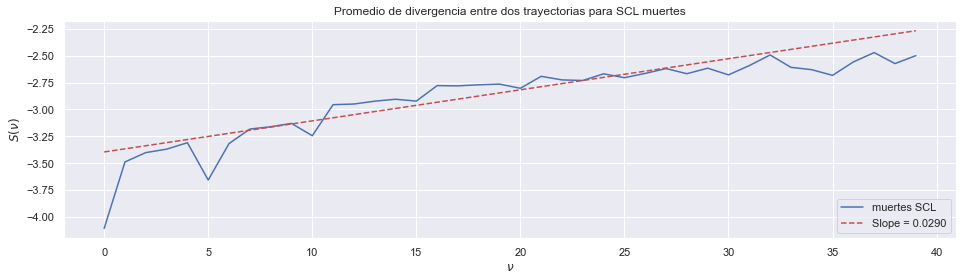

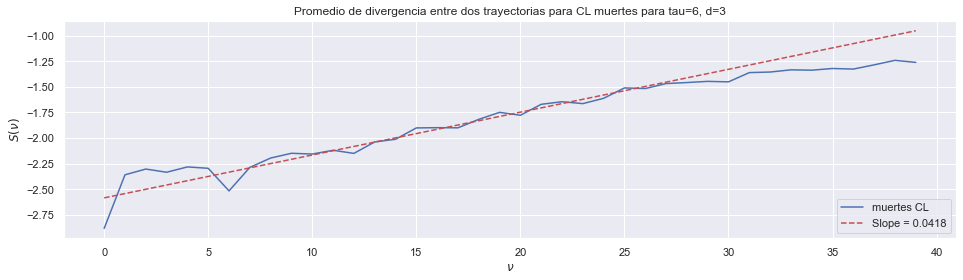

In [101]:
nu = np.arange(len(S_nu_SCL_deaths))

MCLE_SCL_deaths, intercept, r_value, p_value, std_err = sp.stats.linregress(nu[5:33], S_nu_SCL_deaths[5:33])

plt.figure(8, figsize=(16,4))
plt.clf()
plt.plot(nu, S_nu_SCL_deaths, label='muertes SCL')
plt.plot(nu, MCLE_SCL_deaths*nu + intercept, linestyle='--', label='Slope = {:.4f}'.format(MCLE_SCL_deaths), color='r')
plt.title('Promedio de divergencia entre dos trayectorias para SCL muertes')
plt.ylabel('$S(\\nu)$')
plt.xlabel('$\\nu$')
plt.legend(loc=4)
plt.show()


nu = np.arange(len(S_nu_CL_deaths))

MCLE_CL_deaths, intercept, r_value, p_value, std_err = sp.stats.linregress(nu[5:27], S_nu_CL_deaths[5:27])

plt.figure(8, figsize=(16,4))
plt.clf()
plt.plot(nu, S_nu_CL_deaths, label='muertes CL')
plt.plot(nu, MCLE_CL_deaths*nu + intercept, linestyle='--', label='Slope = {:.4f}'.format(MCLE_CL_deaths), color='r')
plt.title('Promedio de divergencia entre dos trayectorias para CL muertes para tau={}, d=3'.format(tau_CL_deaths))
plt.ylabel('$S(\\nu)$')
plt.xlabel('$\\nu$')
plt.legend(loc=4)
plt.show()

In [81]:
data = {'': ['SCL casos', 'SCL casos ICOVID', 'SCL muertes', 'CL muertes'], 'MCLE': 365*np.round([MCLE_SCL_cases, MCLE_SCL_cases_icovid, MCLE_SCL_deaths, MCLE_CL_deaths], 4),'delay': [4, 6, 5, 6]}
NN = pd.DataFrame(data)
NN

,,MCLE,delay
0,SCL casos,18.4325,4
1,SCL casos ICOVID,19.7465,6
2,SCL muertes,10.5850,5
3,CL muertes,15.2570,6
